# 한국 차량 번호판 탐지 데모

이 노트북은 `runs/license_plate_yolov8n/weights/best.pt` 모델을 이용해 단일 이미지에서 번호판 위치를 시각화합니다.

1. 아래 코드 셀의 `IMAGE_PATH`를 탐지할 이미지 경로로 바꾸세요.
2. 셀을 실행하면 번호판 박스가 그려진 이미지와 박스 좌표 및 신뢰도를 확인할 수 있습니다.

> Ultralytics `yolo` 패키지가 설치되어 있어야 하며, 이미 학습된 모델 파일이 존재해야 합니다.


In [14]:
from pathlib import Path
import os
import sys

# 가상환경 경로를 등록해 필요한 패키지를 사용할 수 있게 합니다.
VENV_DIR = Path('venv')
if not VENV_DIR.exists():
    raise FileNotFoundError(f'가상환경을 찾을 수 없습니다: {VENV_DIR}')

site_packages_candidates = sorted((VENV_DIR / 'lib').glob('python*/site-packages'))
if not site_packages_candidates:
    raise FileNotFoundError('site-packages 디렉터리를 찾을 수 없습니다. 가상환경 구성을 확인하세요.')
site_packages_path = site_packages_candidates[0].resolve()

if str(site_packages_path) not in sys.path:
    sys.path.insert(0, str(site_packages_path))

os.environ['VIRTUAL_ENV'] = str(VENV_DIR.resolve())
bin_path = (VENV_DIR / 'bin').resolve()
current_path = os.environ.get('PATH', '')
if current_path:
    path_parts = current_path.split(':')
    if str(bin_path) not in path_parts:
        os.environ['PATH'] = str(bin_path) + ':' + current_path
else:
    os.environ['PATH'] = str(bin_path)

print('가상환경 경로 설정 완료:', VENV_DIR)
print('현재 커널 파이썬:', sys.executable)
venv_python = bin_path / 'python'
if venv_python.exists() and sys.executable != str(venv_python):
    print('⚠️ 현재 커널이 가상환경 파이썬이 아닙니다. 필요한 경우 Jupyter 커널을 전환하세요.')


가상환경 경로 설정 완료: venv
현재 커널 파이썬: /usr/bin/python
⚠️ 현재 커널이 가상환경 파이썬이 아닙니다. 필요한 경우 Jupyter 커널을 전환하세요.


In [15]:
from pathlib import Path
from ultralytics import YOLO

MODEL_PATH = Path("runs/license_plate_yolov8n/weights/best.pt")
if not MODEL_PATH.exists():
    raise FileNotFoundError(f"모델 파일을 찾을 수 없습니다: {MODEL_PATH}")

model = YOLO(MODEL_PATH)
print(f"모델 로드 완료: {MODEL_PATH}")


모델 로드 완료: runs/license_plate_yolov8n/weights/best.pt


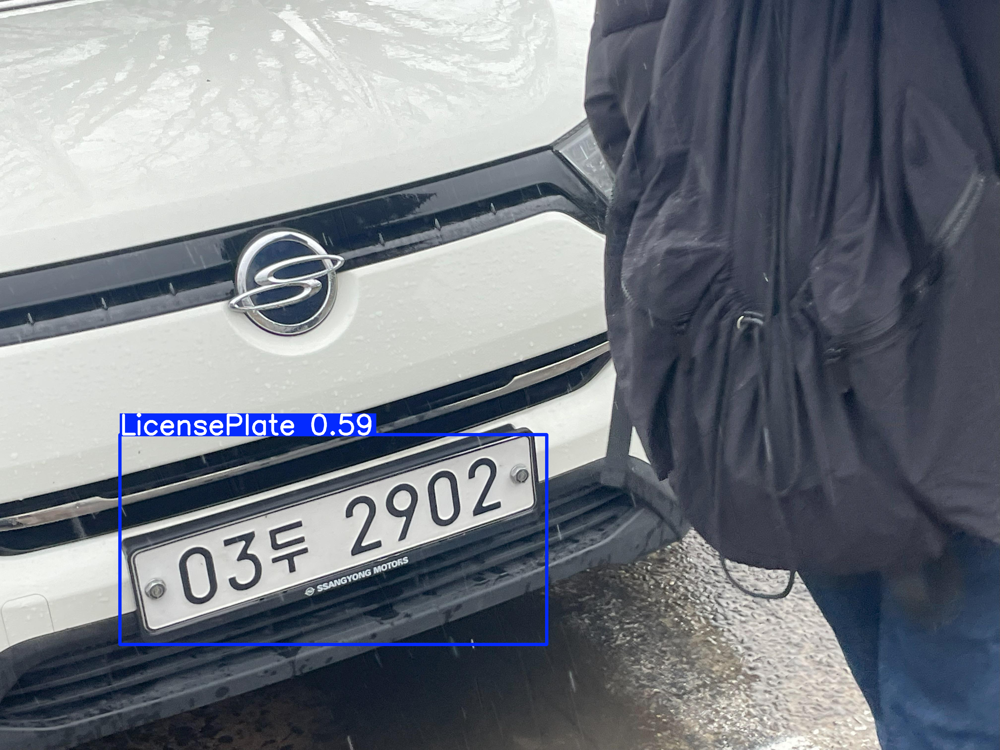

탐지 결과 (좌표는 픽셀 기준입니다.):
 - class=0 conf=0.590 bbox=(483.9, 1752.8, 2204.4, 2598.5)


In [51]:
from pathlib import Path
from IPython.display import display
from PIL import Image

# TODO: 탐지할 이미지 경로를 입력하세요.
# IMAGE_PATH = Path('../Korea Car License Plate/test/images/IMG_2662_jpg.rf.32986920b1a3dd23d146ee571d47913e.jpg')


IMAGE_PATH = Path('samples/example.jpg')

if not IMAGE_PATH.exists():
    raise FileNotFoundError(f"이미지 파일을 찾을 수 없습니다: {IMAGE_PATH}")

results = model.predict(source=str(IMAGE_PATH), conf=0.5, verbose=False)
for result in results:
    annotated_bgr = result.plot()
    annotated_rgb = annotated_bgr[..., ::-1]
    display(Image.fromarray(annotated_rgb))

    boxes = result.boxes.xyxy.cpu().tolist()
    confs = result.boxes.conf.cpu().tolist()
    cls_ids = result.boxes.cls.cpu().tolist()

    if not boxes:
        print("탐지된 번호판이 없습니다.")
        continue

    print("탐지 결과 (좌표는 픽셀 기준입니다.):")
    for (x1, y1, x2, y2), conf, cls_id in zip(boxes, confs, cls_ids):
        print(
            f" - class={int(cls_id)} conf={conf:.3f} bbox=({x1:.1f}, {y1:.1f}, {x2:.1f}, {y2:.1f})"
        )


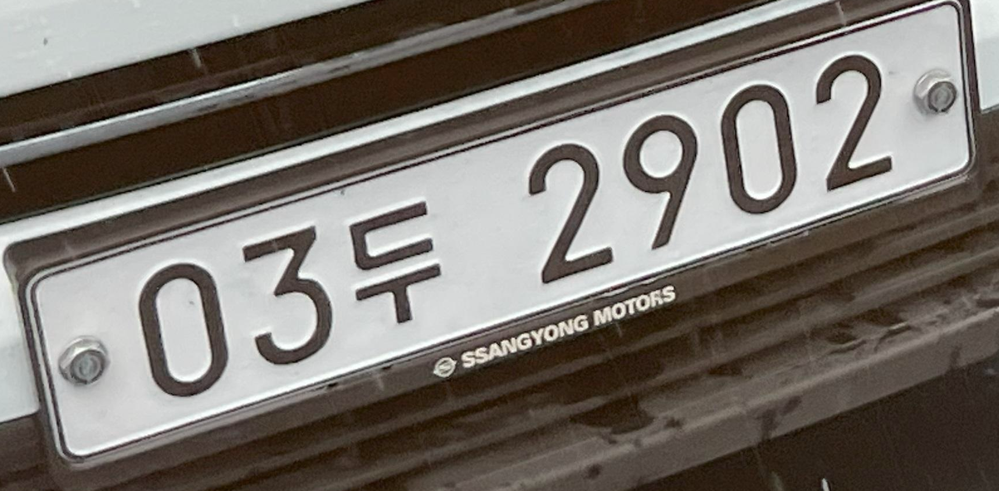

In [62]:
# Get the coordinates of the first (best confidence) bounding box
x1_i, y1_i, x2_i, y2_i = map(int, boxes[0])

# Crop the region from the original image
crop = img[y1_i:y2_i, x1_i:x2_i]

# Display the cropped image
display(Image.fromarray(crop))

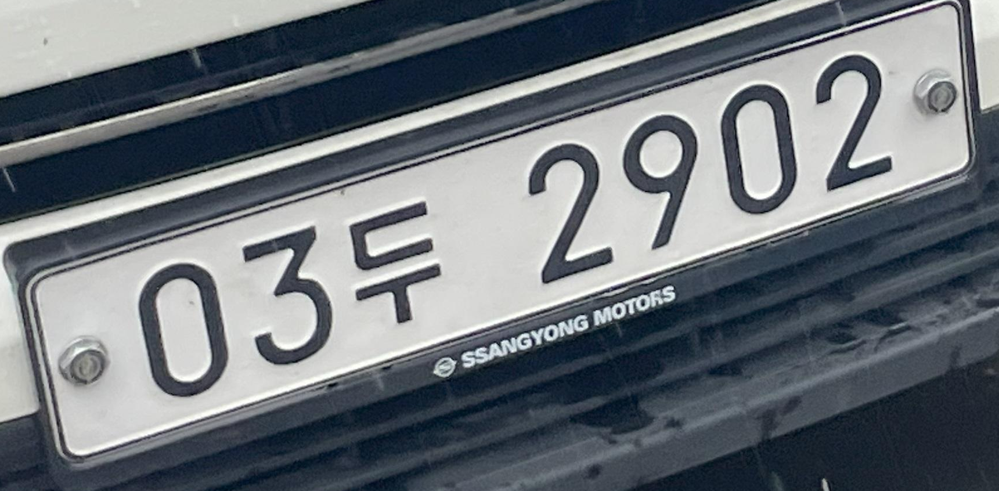

In [63]:
import cv2
import numpy as np

# Read the image using the existing IMAGE_PATH
img = cv2.imread(str(IMAGE_PATH))

# Convert BGR to RGB
rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# Get the coordinates of the first (best confidence) bounding box
x1_i, y1_i, x2_i, y2_i = map(int, boxes[0])

# Crop the region from the original image
crop = rgb[y1_i:y2_i, x1_i:x2_i]

# Display the cropped image
display(Image.fromarray(crop))


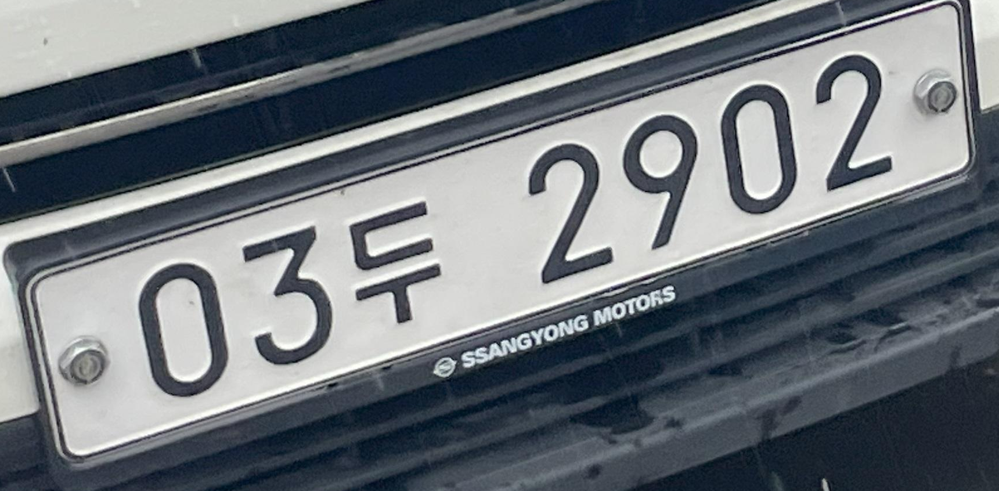

In [64]:
display(Image.fromarray(crop))


In [65]:
import os
os.environ["NUMEXPR_MAX_THREADS"] = "8"


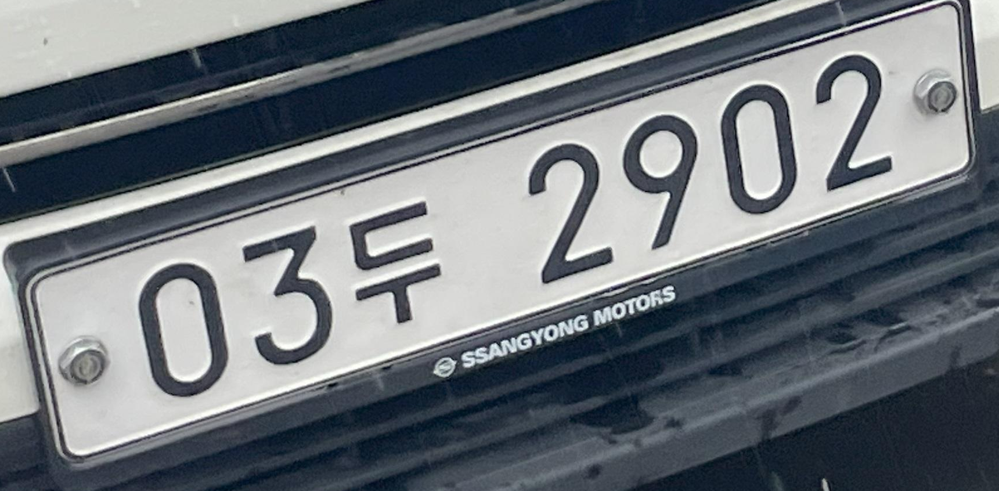

OCR 결과: 


In [73]:
import pytesseract

display(Image.fromarray(crop))
# 번호판 크롭 이미지에서 OCR 수행
ocr_result = pytesseract.image_to_string(crop, lang='kor+eng', config='--psm 1')
print("OCR 결과:", ocr_result.strip())

In [74]:
import cv2, numpy as np
from math import hypot

def warp_plate_from_aligned(
    bgr,
    target_w=900,
    inner=0.08,
    canny=(40,140),                 # 낮은 엣지 임계치
    area_frac=(0.06, 0.98),         # (하한, 상한) 이미지 대비 면적 비율
    ar_range=(2.2, 7.5),            # 종횡비 허용 범위
    eps=0.03,                       # approxPolyDP epsilon 비율(둘레*eps)
    dilate_iter=2,                  # 팽창 횟수
    debug=False
):
    g  = cv2.cvtColor(bgr, cv2.COLOR_BGR2GRAY)
    g  = cv2.bilateralFilter(g, 7, 50, 50)

    # 자동 Canny (median 기반) + 기본값 혼합
    med = np.median(g)
    auto_low  = int(max(0, 0.66*med))
    auto_high = int(min(255, 1.33*med))
    low, high = (min(canny[0], auto_low), max(canny[1], auto_high))

    e  = cv2.Canny(g, low, high)
    e  = cv2.dilate(e, np.ones((3,3),np.uint8), dilate_iter)

    cnts,_ = cv2.findContours(e, cv2.RETR_LIST, cv2.CHAIN_APPROX_SIMPLE)
    H,W = bgr.shape[:2]; area_img = H*W

    best = None; best_score = -1
    for c in cnts:
        peri = cv2.arcLength(c, True)
        approx = cv2.approxPolyDP(c, eps*peri, True)  # ← 0.02 → 0.03로 완화
        if len(approx)!=4 or not cv2.isContourConvex(approx): 
            continue
        area = cv2.contourArea(approx)
        frac = area / (area_img + 1e-6)
        if not (area_frac[0] <= frac <= area_frac[1]): 
            continue

        pts = approx.reshape(-1,2).astype(np.float32)
        # 순서 정렬
        s = pts.sum(axis=1); d = np.diff(pts, axis=1).ravel()
        tl = pts[np.argmin(s)]; br = pts[np.argmax(s)]
        tr = pts[np.argmin(d)]; bl = pts[np.argmax(d)]
        q  = np.array([tl,tr,bl,br], np.float32)

        # 종횡비
        w1 = hypot(*(tr - tl)); w2 = hypot(*(br - bl))
        h1 = hypot(*(bl - tl)); h2 = hypot(*(br - tr))
        w  = max(w1,w2); h = max(h1,h2)
        if h <= 1: 
            continue
        ar = w/h
        if not (ar_range[0] <= ar <= ar_range[1]): 
            continue

        score = frac * ar   # 간단 스코어: 면적×종횡비
        if score > best_score:
            best_score, best = score, q

    if best is None:
        # 최후의 보루: 외접 사각형으로 warp(완전한 원근은 아니지만 OCR엔 도움)
        ys, xs = np.where(e>0)
        if len(xs) == 0:
            return bgr, False, e, None
        rect = cv2.minAreaRect(np.column_stack((xs,ys)))  # (cx,cy),(w,h),angle
        box  = cv2.boxPoints(rect).astype(np.float32)
        best = box

    target_h = int(target_w/4.5)
    dst = np.float32([[0,0],[target_w-1,0],[0,target_h-1],[target_w-1,target_h-1]])
    M = cv2.getPerspectiveTransform(best, dst)
    warped = cv2.warpPerspective(bgr, M, (target_w, target_h))
    pad = int(inner * min(target_w, target_h))
    warped = warped[pad:target_h-pad, pad:target_w-pad]

    return warped, True, e, best  # 이미지, 성공여부, 엣지, 사용한 꼭짓점


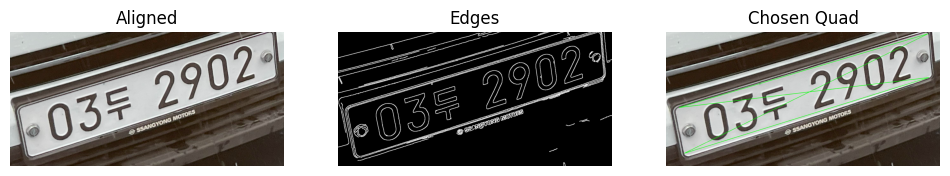

warp ok? True


In [78]:
flat, ok, edges_dbg, quad = warp_plate_from_aligned(
    crop,
    target_w=900,
    inner=0.08,
    canny=(40,140),
    area_frac=(0.06,0.98),
    ar_range=(2.2,7.5),
    eps=0.03,
    dilate_iter=2
)

# 디버그 보기
import matplotlib.pyplot as plt, cv2
vis = crop.copy()
if quad is not None:
    q = quad.astype(int)
    for i in range(4):
        cv2.line(vis, tuple(q[i]), tuple(q[(i+1)%4]), (0,255,0), 2)

plt.figure(figsize=(12,4))
plt.subplot(1,3,1); plt.imshow(cv2.cvtColor(crop, cv2.COLOR_BGR2RGB)); plt.title("Aligned"); plt.axis("off")
plt.subplot(1,3,2); plt.imshow(edges_dbg, cmap="gray"); plt.title("Edges"); plt.axis("off")
plt.subplot(1,3,3); plt.imshow(cv2.cvtColor(vis, cv2.COLOR_BGR2RGB)); plt.title("Chosen Quad"); plt.axis("off")
plt.show()

print("warp ok?", ok)


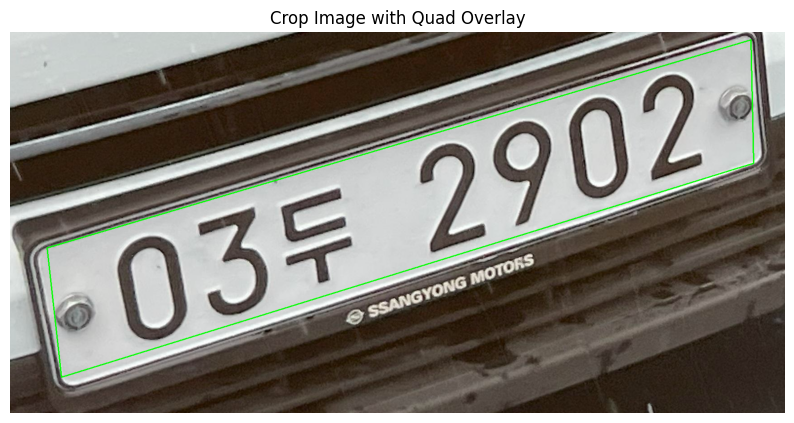

In [108]:
import cv2
import numpy as np

import matplotlib.pyplot as plt

# Create a copy of the crop image to draw on
vis = crop.copy()

# Draw lines between quad points
if quad is not None:
    q = quad.astype(int)
    # Draw green lines for each side of the quadrilateral
    cv2.line(vis, tuple(q[0]), tuple(q[1]), (0,255,0), 2)  # Top line
    cv2.line(vis, tuple(q[1]), tuple(q[3]), (0,255,0), 2)  # Right line 
    cv2.line(vis, tuple(q[3]), tuple(q[2]), (0,255,0), 2)  # Bottom line
    cv2.line(vis, tuple(q[2]), tuple(q[0]), (0,255,0), 2)  # Left line

# Display the result
plt.figure(figsize=(10,8))
plt.imshow(cv2.cvtColor(vis, cv2.COLOR_BGR2RGB))
plt.title("Crop Image with Quad Overlay")
plt.axis('off')
plt.show()

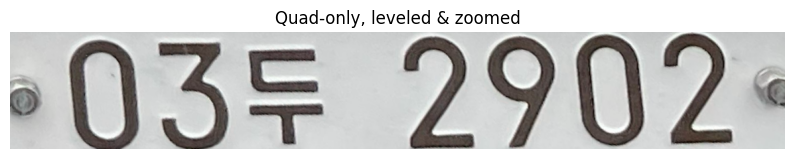

saved: plate_leveled.png


In [119]:
import cv2, numpy as np
import matplotlib.pyplot as plt

def warp_from_quad(img_bgr, quad, out_w=1000, inner_ratio=0.06):
    """
    quad(4x2: TL,TR,BL,BR 순서가 아니어도 됨)를 직사각형으로 투시변환해
    수평으로 편편하게 만든 이미지를 반환합니다.

    - out_w: 결과물 가로 해상도(확대 효과)
    - inner_ratio: 가장자리 제거 비율(0.06 = 6% 안쪽만 남김)
    """
    q = np.asarray(quad, dtype=np.float32)

    # 1) 꼭짓점 순서 정규화 (TL, TR, BL, BR)
    s = q.sum(axis=1); d = np.diff(q, axis=1).ravel()
    tl = q[np.argmin(s)]; br = q[np.argmax(s)]
    tr = q[np.argmin(d)]; bl = q[np.argmax(d)]
    q = np.array([tl, tr, bl, br], np.float32)

    # 2) 목적 크기 계산 (원래 사다리꼴의 비율 보존)
    w_top  = np.linalg.norm(tr - tl)
    w_bot  = np.linalg.norm(br - bl)
    h_left = np.linalg.norm(bl - tl)
    h_right= np.linalg.norm(br - tr)
    avg_w = max(1.0, 0.5 * (w_top + w_bot))
    avg_h = max(1.0, 0.5 * (h_left + h_right))
    out_h = int(out_w * (avg_h / avg_w))

    # 3) 투시변환
    dst = np.float32([[0,0],[out_w-1,0],[0,out_h-1],[out_w-1,out_h-1]])
    M = cv2.getPerspectiveTransform(q, dst)
    rect = cv2.warpPerspective(img_bgr, M, (out_w, out_h))

    # 4) 안쪽으로 살짝 크롭(가장자리 왜곡/프레임 제거)
    if inner_ratio > 0:
        pad = int(inner_ratio * min(out_w, out_h))
        rect = rect[pad:out_h-pad, pad:out_w-pad]

    return rect

# ---- 사용 예시 ----
leveled = warp_from_quad(crop, quad, out_w=1200, inner_ratio=0.08)  # out_w 키우면 더 확대
plt.figure(figsize=(10,4))
plt.imshow(cv2.cvtColor(leveled, cv2.COLOR_BGR2RGB))
plt.title("Quad-only, leveled & zoomed")
plt.axis("off")
plt.show()

# 필요하면 파일로 저장
cv2.imwrite("plate_leveled.png", leveled)
print("saved: plate_leveled.png")


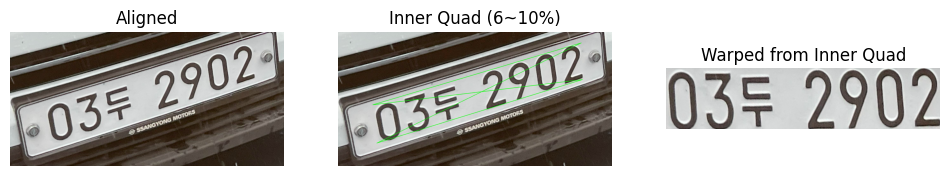

In [121]:
# --- chosen quad 기반 인너크롭(6~10%) + warp ---
import cv2, numpy as np, matplotlib.pyplot as plt

# ⛳ 준비물:
#  - aligned_bgr : quad 좌표가 유효한 원본/크롭 BGR 이미지 (예: crop)
#  - quad        : np.float32 (4,2) 아무 순서여도 OK → 아래에서 정렬

# 1) 소스 이미지 지정 (번호판 크롭 이미지)
aligned_bgr = crop.copy()   # ← quad가 이 이미지 좌표계 기준일 때

# 2) quad 준비(순서 정렬: TL, TR, BL, BR)
def order_quad(pts):
    pts = np.asarray(pts, np.float32)
    s = pts.sum(axis=1); d = np.diff(pts, axis=1).ravel()
    tl = pts[np.argmin(s)]; br = pts[np.argmax(s)]
    tr = pts[np.argmin(d)]; bl = pts[np.argmax(d)]
    return np.array([tl, tr, bl, br], np.float32)

assert 'quad' in globals(), "quad (4x2) 꼭짓점이 필요합니다."
chosen_quad = order_quad(quad)

def inner_warp_from_quad(img_bgr, quad_src, inner_ratio=0.08, target_w=900):
    """quad 안쪽으로 inner_ratio 만큼 수축한 사각형을 원본 좌표계에서 구해 warp."""
    H, W = img_bgr.shape[:2]
    target_h = int(target_w / 4.5)

    # 1) quad_src -> 정규 직사각형으로 가는 호모그래피
    dst_rect = np.float32([[0,0],[target_w-1,0],[0,target_h-1],[target_w-1,target_h-1]])
    H_src2dst = cv2.getPerspectiveTransform(quad_src, dst_rect)
    H_dst2src = np.linalg.inv(H_src2dst)

    # 2) 목적 좌표계에서 "안쪽 사각형" 정의 (6~10% 권장)
    r = float(inner_ratio)
    inner_dst = np.float32([
        [ r*target_w,      r*target_h],
        [(1-r)*target_w-1, r*target_h],
        [ r*target_w,      (1-r)*target_h-1],
        [(1-r)*target_w-1, (1-r)*target_h-1],
    ])

    # 3) 안쪽 사각형을 다시 원본 좌표계로 투영 → inner_quad_src
    inner_src = cv2.perspectiveTransform(inner_dst[None, :, :], H_dst2src)[0].astype(np.float32)

    # 4) inner_quad_src -> 전체 직사각형으로 warp
    M = cv2.getPerspectiveTransform(inner_src, dst_rect)
    warped = cv2.warpPerspective(img_bgr, M, (target_w, target_h))
    return warped, inner_src

# 실행
flat_cropped_bgr, inner_quad = inner_warp_from_quad(
    aligned_bgr, chosen_quad, inner_ratio=0.08, target_w=900
)

# 디버그 시각화(원본에 inner_quad overlay)
vis = aligned_bgr.copy()
iq = inner_quad.astype(int)
for i in range(4):
    cv2.line(vis, tuple(iq[i]), tuple(iq[(i+1)%4]), (0,255,0), 2)

plt.figure(figsize=(12,4))
plt.subplot(1,3,1); plt.imshow(cv2.cvtColor(aligned_bgr, cv2.COLOR_BGR2RGB)); plt.title("Aligned"); plt.axis("off")
plt.subplot(1,3,2); plt.imshow(cv2.cvtColor(vis, cv2.COLOR_BGR2RGB));       plt.title("Inner Quad (6~10%)"); plt.axis("off")
plt.subplot(1,3,3); plt.imshow(cv2.cvtColor(flat_cropped_bgr, cv2.COLOR_BGR2RGB)); plt.title("Warped from Inner Quad"); plt.axis("off")
plt.show()


/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 46160 (\N{HANGUL SYLLABLE DU}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


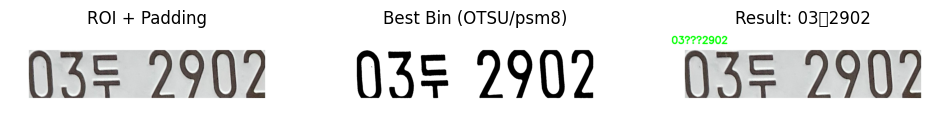

RAW      : 03두2902
정규화   : 03두2902
스코어   : 3


In [122]:
# --- 왼쪽 누락 방지: 인너크롭↓ + 흰색 패딩 + 재OCR ---
import cv2, numpy as np, pytesseract, re, matplotlib.pyplot as plt

flat_cropped_bgr
# 1) (선택) 인너크롭 6%로 재생성해서 너무 많이 자른 경우 방지
def inner_crop(img_bgr, inner_ratio=0.06):
    h, w = img_bgr.shape[:2]
    pad = int(inner_ratio * min(h, w))
    return img_bgr[pad:h-pad, pad:w-pad]

roi = inner_crop(flat_cropped_bgr, inner_ratio=0.06)

# 2) 흰색 패딩(주변 여백) 추가: 좌/우/상/하 8% (상황 따라 6~12% 조절)
def pad_white(img_bgr, ratio=0.08):
    h, w = img_bgr.shape[:2]
    p = int(ratio * max(h, w))
    return cv2.copyMakeBorder(img_bgr, p, p, p, p, cv2.BORDER_CONSTANT, value=(255,255,255))

roi_pad = pad_white(roi, ratio=0.08)

# 3) 전처리: 해상도 ↑ + CLAHE + 이진화 + 획 메우기
g = cv2.cvtColor(roi_pad, cv2.COLOR_BGR2GRAY)
g = cv2.resize(g, None, fx=2.4, fy=2.4, interpolation=cv2.INTER_CUBIC)
g = cv2.createCLAHE(2.0, (8,8)).apply(g)

# 후보 이진화 몇 가지
_, b1 = cv2.threshold(g, 0, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)
b2 = cv2.adaptiveThreshold(g,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C,cv2.THRESH_BINARY,31,2)
b3 = cv2.adaptiveThreshold(g,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C,cv2.THRESH_BINARY,41,4)
k3 = np.ones((3,3), np.uint8)
b4 = cv2.morphologyEx(b2, cv2.MORPH_CLOSE, k3, 1)  # 끊긴 획 메우기

bins = [("OTSU", b1), ("ADP31_C2", b2), ("ADP41_C4", b3), ("CLOSE_ADP", b4)]

PLATE_RE = re.compile(r"\b\d{2,3}[가-힣]-?\d{4}\b")
ALLOWED_KOR = "가나다라마바사아자배허하호국영군임관학무두진경철성명신민박천원창효준현석수수"
SUBS = str.maketrans({"O":"0","o":"0","I":"1","l":"1","S":"5","B":"8","D":"0","—":"-"})

def ocr_once(bimg, psm=7):
    cfg = (f"--oem 1 --psm {psm} -l kor+eng "
           f"-c tessedit_do_invert=0 -c load_system_dawg=0 -c load_freq_dawg=0 "
           f"-c tessedit_char_whitelist={ALLOWED_KOR}0123456789-")
    raw = pytesseract.image_to_string(bimg, config=cfg)
    txt = re.sub(r"[^0-9가-힣- ]", "", raw.translate(SUBS)).strip().replace(" ", "")
    score = 3 if PLATE_RE.fullmatch(txt) else (2 if PLATE_RE.search(txt) else 0)
    return txt, score, raw.strip()

best = {"txt":"", "score":-1, "raw":"", "name":"", "img":None, "psm":7}
cands = []
for name, b in bins:
    for psm in (7, 8, 6, 13):
        t, s, r = ocr_once(b, psm)
        cands.append((f"{name}/psm{psm}", t, s))
        if s > best["score"]:
            best.update(txt=t, score=s, raw=r, name=name, img=b, psm=psm)

# 시각화
plt.figure(figsize=(12,4))
plt.subplot(1,3,1); plt.imshow(cv2.cvtColor(roi_pad, cv2.COLOR_BGR2RGB)); plt.title("ROI + Padding"); plt.axis("off")
plt.subplot(1,3,2); plt.imshow(best["img"], cmap="gray"); plt.title(f"Best Bin ({best['name']}/psm{best['psm']})"); plt.axis("off")
ov = roi_pad.copy()
if best["txt"]:
    cv2.putText(ov, best["txt"], (20, max(40, ov.shape[0]//7)), cv2.FONT_HERSHEY_SIMPLEX, 1.2, (0,255,0), 3)
plt.subplot(1,3,3); plt.imshow(cv2.cvtColor(ov, cv2.COLOR_BGR2RGB)); plt.title(f"Result: {best['txt'] or '—'}"); plt.axis("off")
plt.show()

print("RAW      :", best["raw"])
print("정규화   :", best["txt"])
print("스코어   :", best["score"])